In [1]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import scipy.io 
%matplotlib inline
%load_ext autoreload
%autoreload 2

import os, glob, cv2

# packages needed for making a dataset: 
from torch.utils.data import DataLoader
from torchvision import transforms

from diffuser_utils import *
import dataset as ds
import models.spectral_model as sm

from datetime import date, datetime

import sys
sys.path.append("..")

from models.unet import Unet

from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

# Training a reconstruction network for SpectralDefocusCam

### Setup: Check which GPU is free and choose one

In [2]:
!gpustat

/bin/bash: gpustat: command not found


In [3]:
os.environ["CUDA_DEVICE_ORDER"]= "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]= "3" #choose the number of gpu that's free. It goes from 0-3

In [4]:
device = 'cuda:0'

###  Options 

In [5]:
num_input_images = 2         # How many defocused measurements should we use 
blur_type = 'symmetric'     # Should the blur be 'symmetric' or 'asymmetric'
optimize_blur = False       # optimize the blur
today = datetime.now()       # Get the data/time


## Step 1: Defining a Pytorch dataset and dataloader

In [6]:
# The below folder has a bunch of .mat files with hyperspectral images 
allFiles = glob.glob('/home/kyanny_waller/summerResearch/CZ_hsdb/*.mat')

First, let's divide the images into two categories: a training set and a test set.
The training set will be used to train the reconstruction network, and the test set can be used to check how well the network generalizes to images that it hasn't seen before during training.  

In practice, you'll also want to include a validation set. Learn more about training/test/validation sets here: https://towardsdatascience.com/train-validation-and-test-sets-72cb40cba9e7 

In [7]:
allFilesTest = allFiles[45:-1]
allFilesTrain = allFiles[0:45]

print('number of images in Training set:', len(allFilesTrain))
print('number of images in Test set:',  len(allFilesTest))

number of images in Training set: 45
number of images in Test set: 4


Now that we have a list of images in the training/test sets, we can create a dataset in Pytorch. 
Learn more about why we do this here: https://pytorch.org/tutorials/beginner/basics/data_tutorial.html 

We've written a custom dataset that can be used to load in the hyperspectral images.  Please take a look and familiarize yourself with how we do this in dataset.py. You might need to change this and customize it to if you want to add new datasets or create your own dataset later. 

In addition, we pass in a 'Transform' to the dataset. What this means is that every time we load an image, we'll automatically apply these functions to each image. Right now, we resize every image to be [256 x 256], choose only the first 30 spectral bands, apply a random flip, and then convert the numpy array to a tensor. 

Note: the convention in numpy is to have [height, width, color], whereas in pytorch it's [batch, color, height, width]. We use '.transpose(2,0,1)' to change from the numpy convection to the pytorch convention, and then need to use '.transpose(1,2,0)' to go back to the numpy convention. 


In [11]:
# Create our training and testing datasets: 
training_data = ds.SpectralDataset(allFilesTrain, transform = transforms.Compose([ds.Resize(), 
                                                                                  ds.chooseSpectralBands(),
                                                                                  ds.RandFlip(), ds.Normalize(), ds.toTensor()]), tag = 'ref')
test_data = ds.SpectralDataset(allFilesTest, transform = transforms.Compose([ds.Resize(), 
                                                                             ds.chooseSpectralBands(), ds.Normalize(),
                                                                             ds.toTensor()]), tag = 'ref')

In [12]:
# One way to get an image from out dataset is to use .__getitem__(ind)
sample = training_data.__getitem__(4)

print(sample)
print('shape of hyperspectral image:', sample['image'].shape)

{'image': tensor([[[0.0105, 0.0133, 0.0172,  ..., 0.0151, 0.0129, 0.0151],
         [0.0128, 0.0150, 0.0156,  ..., 0.0117, 0.0148, 0.0122],
         [0.0117, 0.0156, 0.0121,  ..., 0.0185, 0.0170, 0.0164],
         ...,
         [0.0059, 0.0053, 0.0044,  ..., 0.0236, 0.0256, 0.0242],
         [0.0059, 0.0076, 0.0066,  ..., 0.0277, 0.0261, 0.0248],
         [0.0068, 0.0074, 0.0088,  ..., 0.0284, 0.0235, 0.0273]],

        [[0.0157, 0.0187, 0.0252,  ..., 0.0207, 0.0173, 0.0205],
         [0.0177, 0.0198, 0.0170,  ..., 0.0192, 0.0194, 0.0155],
         [0.0190, 0.0202, 0.0168,  ..., 0.0255, 0.0226, 0.0218],
         ...,
         [0.0057, 0.0069, 0.0063,  ..., 0.0363, 0.0372, 0.0358],
         [0.0100, 0.0095, 0.0079,  ..., 0.0390, 0.0376, 0.0363],
         [0.0083, 0.0095, 0.0098,  ..., 0.0395, 0.0329, 0.0382]],

        [[0.0224, 0.0304, 0.0420,  ..., 0.0353, 0.0277, 0.0311],
         [0.0275, 0.0330, 0.0276,  ..., 0.0280, 0.0318, 0.0249],
         [0.0282, 0.0313, 0.0292,  ..., 0.0447, 

Notice that this returms a dictionary (sample), which has the tensor 'image'. Typically, the dictionary will contain both the input to the network, as well as the label. Here, we can think of 'image' as our groud truth label. Since we're simulating our encoded Spectral DefocusCam image, we don't have an 'input' image here, since we'll create this later. 

Note for later: To speed up training, it's often useful to pre-compute the encoded Spectral DefocusCam image and then load it in similarly to how we load in 'image'. 

We can plot the loaded image by converting it to numpy and transposing the color and spatial dimensions.

tensor shape:  torch.Size([30, 256, 256])  numpy shape: (256, 256, 30)


Text(0.5, 1.0, '5th slice of hyperspectral image')

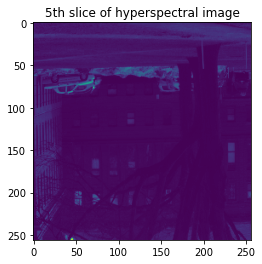

In [13]:
image_tensor = sample['image']
image_np = image_tensor.numpy().transpose(1,2,0)
print('tensor shape: ', image_tensor.shape, ' numpy shape:', image_np.shape)
plt.imshow(image_np[...,5]); plt.title('5th slice of hyperspectral image')

Now we can create out dataloaders, which will help us automatically iterate through all of the images in the dataset. The dataloaders have two useful arguments:
* batch size. Here we can choose the batch size (how many images to process at a time during training). Typically, you'll want to make the batch size as large as possible, so long as it still fits on the GPU. In practice for comp-imaging, we often must process very large images/volumes, so we often keep the batch size at 1 (since we can barely fit things on the GPU as it is). 
* shuffle. This will automatically randomize the order of the images each time it goes through the dataset. This is useful for training, since you'll see the images in a random order each time. For testing, we can have shuffle = False and keep the images in the same order.

In [14]:
train_dataloader = DataLoader(training_data, batch_size=1, shuffle=True)
test_dataloader = DataLoader(test_data, batch_size=1, shuffle=True)

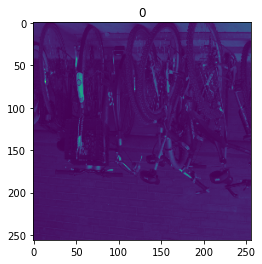

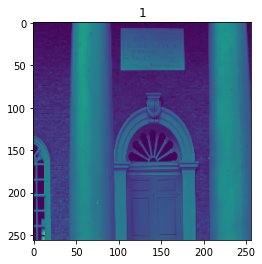

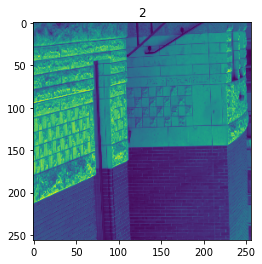

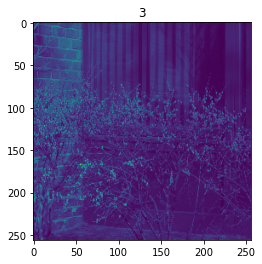

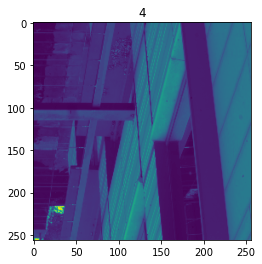

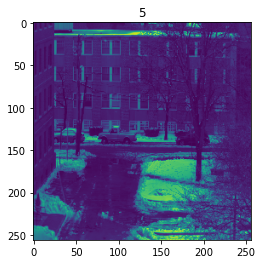

"\nprint('-------------------test images-------------------------')\nfor i, sample in enumerate(test_dataloader):\n    image_np = sample['image'][0].numpy().transpose(1,2,0)\n    plt.imshow(np.mean(image_np,-1)); plt.title(i)\n    plt.show()\n    if i == 2:\n        break\n"

In [15]:
for i, sample in enumerate(train_dataloader): 
    image_tensor = sample['image']
    image_np = image_tensor[0].numpy().transpose(1,2,0)
    plt.imshow(np.mean(image_np,-1)); plt.title(i)
    plt.show()
    if i == 5:
        break
'''
print('-------------------test images-------------------------')
for i, sample in enumerate(test_dataloader):
    image_np = sample['image'][0].numpy().transpose(1,2,0)
    plt.imshow(np.mean(image_np,-1)); plt.title(i)
    plt.show()
    if i == 2:
        break
'''

In [16]:
# Note that now the tensor dimensions are [1, 30, 256, 256] because we have a batch size of 1
print(image_tensor.shape)


torch.Size([1, 30, 256, 256])


### Step 2: Define forward model 

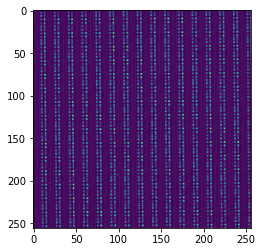

In [17]:
# first, load the spectral response mask (in diffuser_utils.py)
# we automatically crop the mask to [256x256] in the load_mask function. (feel free to change this)
mask = load_mask()
plt.figure()
plt.imshow(mask[...,10])

Now we can define the forward model in pytorch. This is very similar to what we did in 'spectral_diffuser_defocuscam_tutorial', but in pytorch instead of numpy. Look back between the two and convince yourself that these are equivalent. 


In [18]:
class Forward_Model(torch.nn.Module):
    # Model initialization 
    def __init__(self, mask,               # mask: response matrix for the spectral filter array
                 num_ims = 2,              # number of blurred images to simulate
                 w_init = None,            # initialization for the blur kernels e.g., w_init = [.01, 0.01]
                 cuda_device = 0,          # cuda device parameter 
                 blur_type = 'symmetric',  # symmetric or asymmetric blur kernel 
                 optimize_blur = False):   # choose whether to learn the best blur or not (warning, not stable)
        super(Forward_Model, self).__init__()
        
        self.cuda_device = cuda_device
        self.blur_type  = blur_type
       
    
         ## Initialize constants
        self.DIMS0 = mask.shape[0]  # Image Dimensions
        self.DIMS1 = mask.shape[1]  # Image Dimensions
        self.PAD_SIZE0 = int((self.DIMS0))     # Pad size
        self.PAD_SIZE1 = int((self.DIMS1))     # Pad size
        
        self.num_ims = num_ims
        
        if w_init is None: #if no blur specified, use default
            if self.blur_type == 'symmetric':
                w_init = np.linspace(.002, .1, num_ims)
            else:
                w_init = np.linspace(.002, .1, num_ims)
                w_init =  np.repeat(np.array(w_init)[np.newaxis], self.num_ims, axis = 0).T
                w_init[:,1] *=.5
             
        print('optimize blur', optimize_blur)
        if self.blur_type == 'symmetric':
            #self.w_init =  np.repeat(np.array(w_init[0])[np.newaxis], self.num_ims, axis = 0)
            self.w_init = w_init
            self.w_blur = torch.nn.Parameter(torch.tensor(self.w_init, dtype = torch.float32, 
                                                          device = self.cuda_device,
                                                         requires_grad = optimize_blur))
        else:
            self.w_init =  w_init
            self.w_blur = torch.nn.Parameter(torch.tensor(self.w_init, dtype = torch.float32, 
                                                          device = self.cuda_device,
                                                         requires_grad = optimize_blur))

        # set up grid 
        x=np.linspace(-1,1,self.DIMS0); 
        y=np.linspace(-1,1,self.DIMS1); 
        X,Y=np.meshgrid(x,y)
        
        self.X = torch.tensor(X, dtype=torch.float32, device=self.cuda_device)
        self.Y = torch.tensor(Y, dtype=torch.float32, device=self.cuda_device)
        
        self.mask = np.transpose(mask, (2,0,1))
        self.mask_var = torch.tensor(self.mask, dtype=torch.float32, device=self.cuda_device).unsqueeze(0)
        self.psf = np.empty((num_ims, self.DIMS0, self.DIMS1))
        
    # Forward model for blur
    def Hfor(self, i):
        if self.blur_type == 'symmetric':
            psf= torch.exp(-((self.X/self.w_blur[i])**2+(self.Y/self.w_blur[i])**2))
        else:
            psf= torch.exp(-((self.X/self.w_blur[i,0])**2+(self.Y/self.w_blur[i,1])**2))
            
        psf = psf/torch.linalg.norm(psf, ord=float('inf'))
        
        self.psf[i] = psf.detach().cpu().numpy()
        
        h_complex = pad_zeros_torch(self,torch.complex(psf,torch.zeros_like(psf)).unsqueeze(0))
        H = torch.fft.fft2(ifftshift2d(h_complex), norm = 'ortho')

        HX = H*self.Xi
        out = torch.fft.ifft2(HX)
        out_r= out.real
        
        return out_r
    
    # forward call for the model
    def forward(self, in_image):

        x = my_pad(self, in_image)                  # pad image
        xc = torch.complex(x, torch.zeros_like(x))  # make into a complex number (needed for FFT)
        self.Xi = torch.fft.fft2(xc)                # Take FFT of image 

        # Generate simulated images for each blur amount 
        out_list = []
        for i in range(0,self.num_ims):
            output = torch.sum(self.mask_var * crop_forward(self,  self.Hfor(i)), 1)
            output= output/torch.max(output)
            out_list.append(output)
        final_output = torch.stack(out_list, 1)

        return final_output

In [19]:
 blur_type = 'symmetric'

In [20]:
imaging_model= Forward_Model(mask, num_ims = num_input_images, blur_type = blur_type) 

optimize blur False


torch.Size([1, 30, 256, 256])
image np shape: (256, 256, 30)


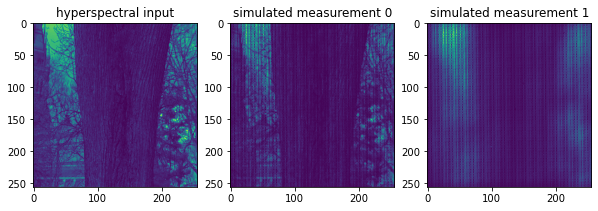

torch.Size([1, 30, 256, 256])
image np shape: (256, 256, 30)


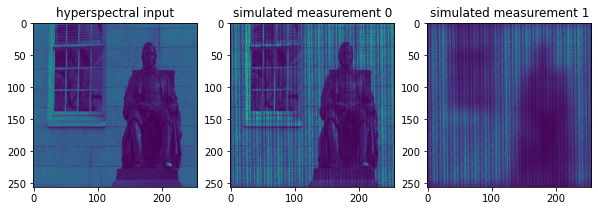

In [21]:
for i, sample in enumerate(train_dataloader): 
    image_tensor = sample['image']
    print(image_tensor.shape)
    simulated_meas = imaging_model(image_tensor.to(device))
    
    image_np = image_tensor[0].numpy().transpose(1,2,0)
    print(f"image np shape: {image_np.shape}")
    
    fig, ax = plt.subplots(1,1 + num_input_images, figsize = (10, 20))
    ax[0].imshow(np.mean(image_np,-1)); 
    ax[0].set_title('hyperspectral input')
    for j in range(0,num_input_images):
        ax[1+j].imshow(simulated_meas[0].detach().cpu().numpy()[j])
        ax[1+j].set_title('simulated measurement '+ str(j))
    plt.show()
    if i == 1:
        break
    

We can also look at the blur kernel:

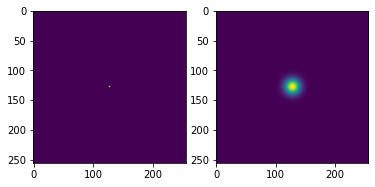

In [20]:
fig, ax = plt.subplots(1,num_input_images)
for j in range(0,num_input_images):
    ax[j].imshow(imaging_model.psf[j]); 

## Defining a reconstruction model

In the previous tutorial, we used FISTA as the reconstruction model. Here, we'll use a CNN instead. A common CNN for imaging tasks is a U-Net.

In [52]:
recon_model = Unet(n_channel_in=num_input_images, n_channel_out=30) # Recon model, gets out image from measurement
recon_model.to('cuda:0');

# for convenience, we can combine both models into an ensemble, 
# so when we call this model we will do both the forward model and the recon
model = sm.MyEnsemble(imaging_model.to(device), recon_model.to(device)) # Combine both models so we can jointly optimize

if optimize_blur == False:
    model.model1.w_blur.requires_grad = False

NameError: name 'imaging_model' is not defined

# Training the recon network

First, let's make a folder to save all of our results in. You can keep track of any options and add them to the args_dict so that you can more easily keep track of different experiments.

In [22]:
# Makes a dictionary to keep track of the options you chose 
args_dict = {'number_measurements': str(num_input_images),
            'blur_type': blur_type,
             'optimize_blur': str(optimize_blur),
            'date': "_".join([str(today.year), str(today.month), str(today.day), str(today.hour)])}

save_folder = 'saved_models/checkpoint_'+"_".join(list(args_dict.values())) + '/'

print(args_dict)

{'number_measurements': '2', 'blur_type': 'symmetric', 'optimize_blur': 'False', 'date': '2021_10_30_15'}


In [23]:
from torch.nn import MSELoss, L1Loss
from torch.optim import Adam
from torch.utils.data import DataLoader

# This is our loss function 
loss_function = L1Loss() 

# We can use the Adam optimizer, which is a standard optimizer used in machine learning
optimizer = Adam(model.parameters(), lr=0.001)

In [24]:
def run_test():
    # Calculate the loss on the images in the test set
    test_loss = 0
    for sample in test_dataloader:
        output = model(sample['image'].to(device))   # Compute the output image 
        loss = loss_function(output, sample['image'].to(device)) # Compute the loss
        test_loss += loss.item()
    test_loss = test_loss/test_dataloader.__len__()
        
    return test_loss

In each epoch:
    For each image in our batch:
        - Compute the forward model to simulate image measurements
        - Compute the loss using L1loss, our loss function
        - Update the model 
        - Enforce a physical constraint?
    Record the average loss per sample as train_loss.
    Record the average loss on the test data after each epoch as test_loss
    Q: What is the point of reassigning net_output_np in every inner loop?
    Q: Can we discuss from a higher level what each image here is an what the loss/learned represents?
    Q: Is the i not incrementing properly in the prints?

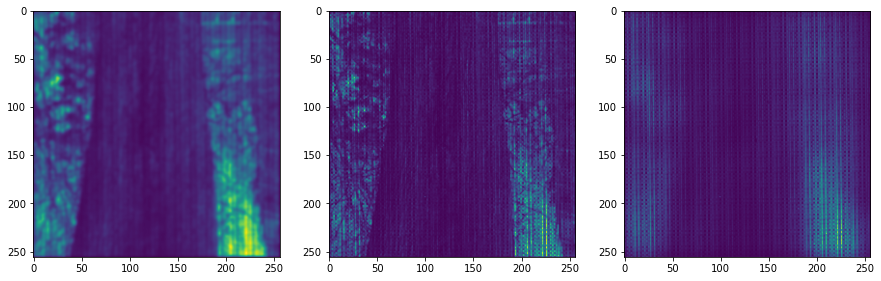

Total Train Loss ( 0 ): 	 0.0577 Total Test Loss ( 0 ): 	 0.0463 learned [0.002 0.1  ]


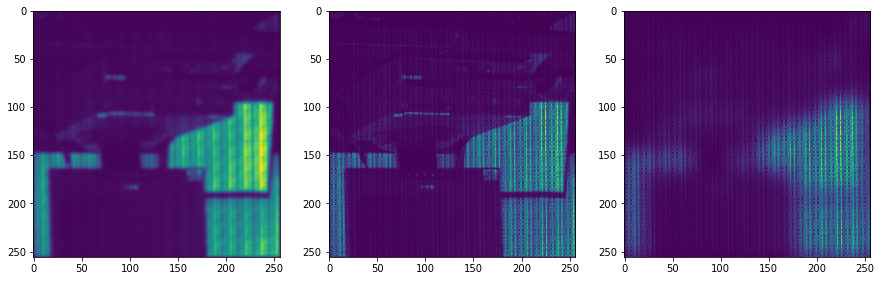

Total Train Loss ( 1 ): 	 0.0596 Total Test Loss ( 1 ): 	 0.0451 learned [0.002 0.1  ]


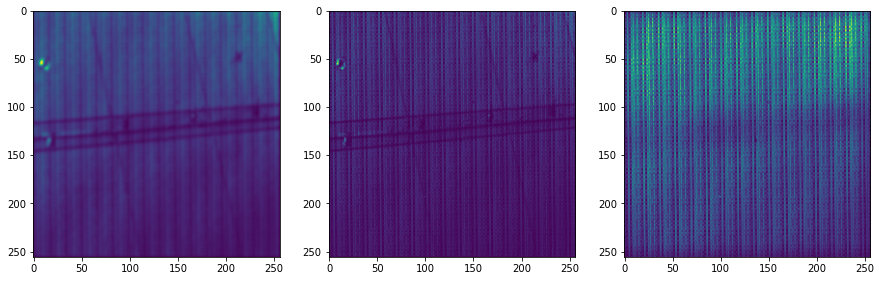

Total Train Loss ( 2 ): 	 0.0546 Total Test Loss ( 2 ): 	 0.0448 learned [0.002 0.1  ]


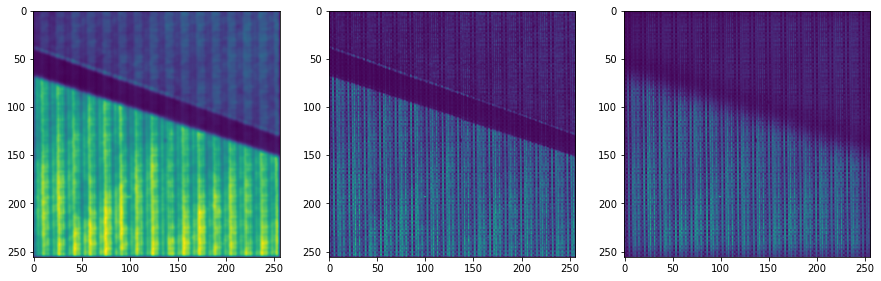

Total Train Loss ( 3 ): 	 0.051 Total Test Loss ( 3 ): 	 0.0405 learned [0.002 0.1  ]


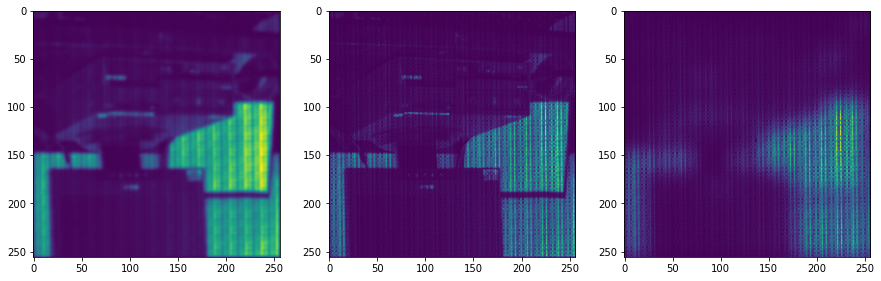

Total Train Loss ( 4 ): 	 0.0587 Total Test Loss ( 4 ): 	 0.0421 learned [0.002 0.1  ]


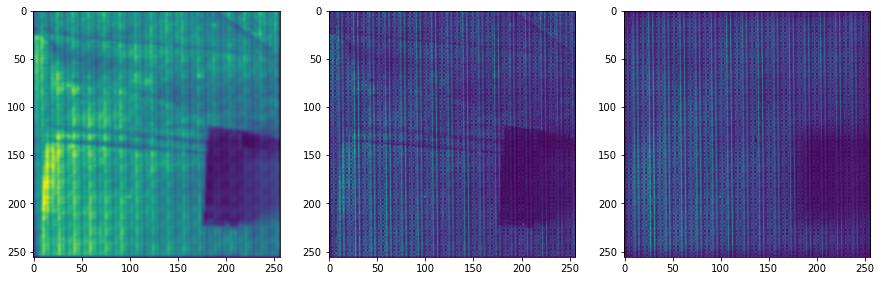

Total Train Loss ( 5 ): 	 0.052 Total Test Loss ( 5 ): 	 0.0424 learned [0.002 0.1  ]


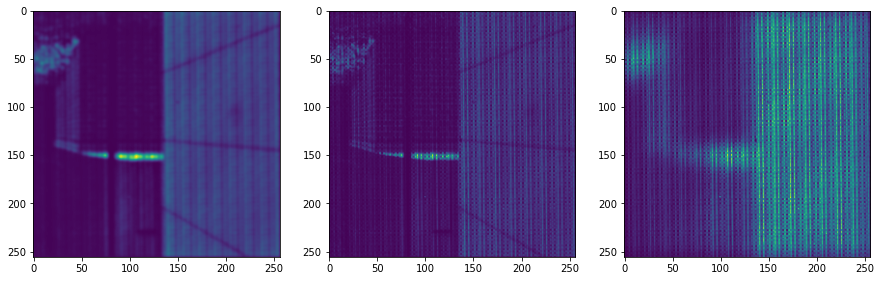

Total Train Loss ( 6 ): 	 0.0594 Total Test Loss ( 6 ): 	 0.0413 learned [0.002 0.1  ]


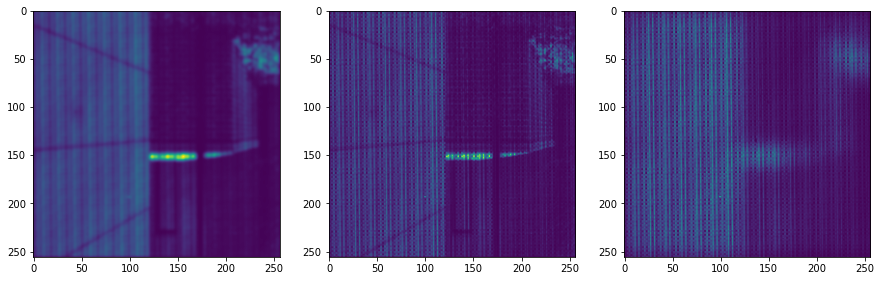

Total Train Loss ( 7 ): 	 0.0524 Total Test Loss ( 7 ): 	 0.047 learned [0.002 0.1  ]


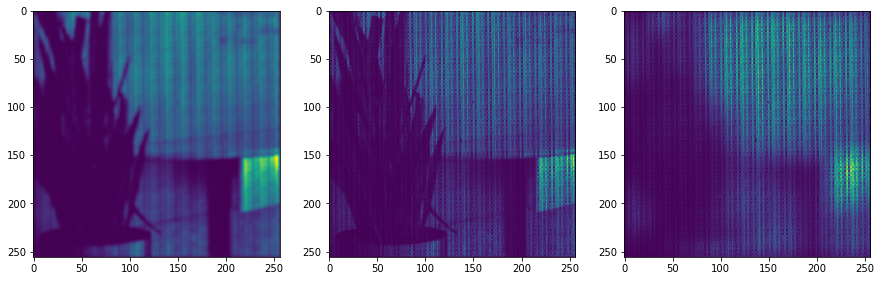

Total Train Loss ( 8 ): 	 0.0517 Total Test Loss ( 8 ): 	 0.0408 learned [0.002 0.1  ]


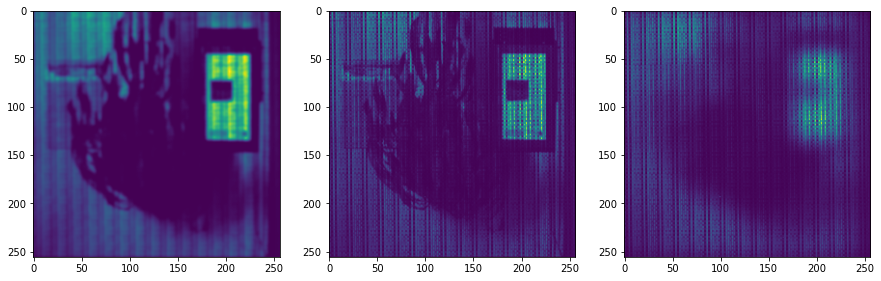

Total Train Loss ( 9 ): 	 0.047 Total Test Loss ( 9 ): 	 0.0395 learned [0.002 0.1  ]


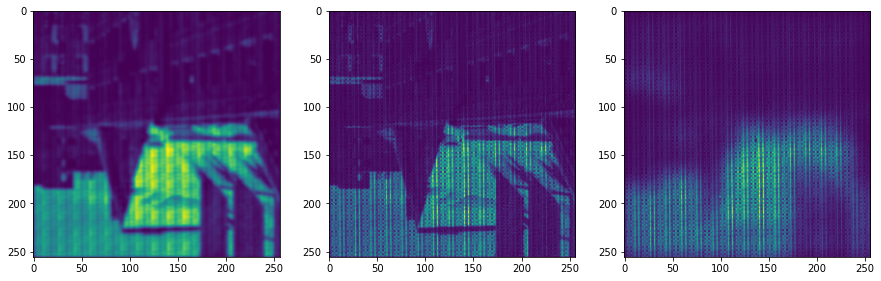

Total Train Loss ( 10 ): 	 0.049 Total Test Loss ( 10 ): 	 0.0417 learned [0.002 0.1  ]


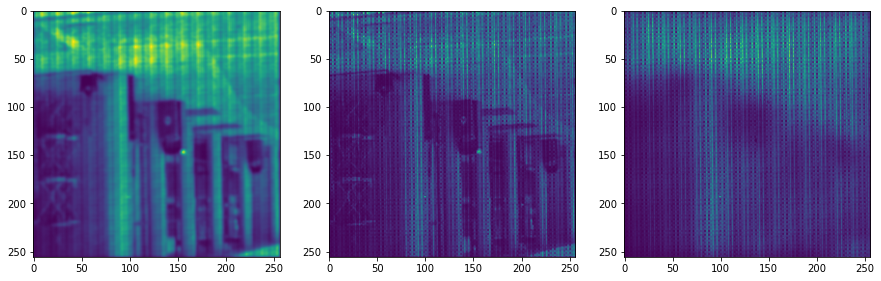

Total Train Loss ( 11 ): 	 0.0536 Total Test Loss ( 11 ): 	 0.0373 learned [0.002 0.1  ]


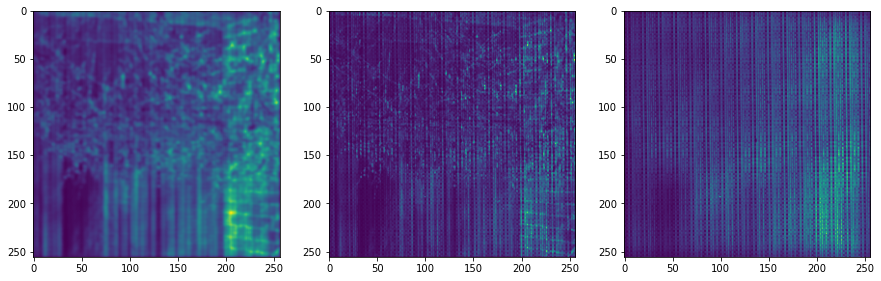

Total Train Loss ( 12 ): 	 0.0497 Total Test Loss ( 12 ): 	 0.0384 learned [0.002 0.1  ]


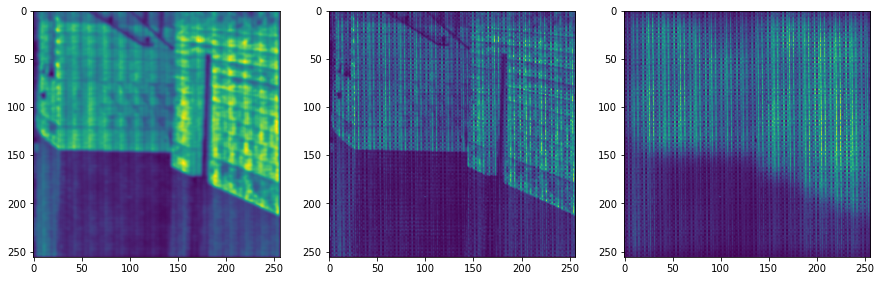

Total Train Loss ( 13 ): 	 0.0458 Total Test Loss ( 13 ): 	 0.0396 learned [0.002 0.1  ]


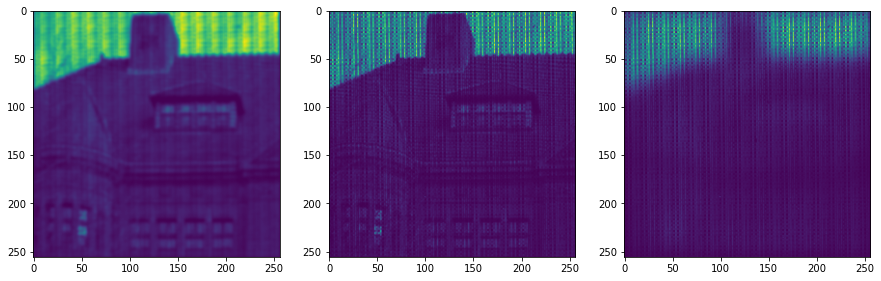

Total Train Loss ( 14 ): 	 0.0483 Total Test Loss ( 14 ): 	 0.0385 learned [0.002 0.1  ]


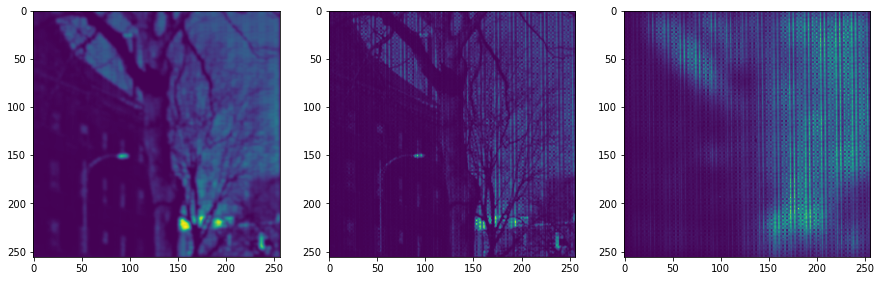

Total Train Loss ( 15 ): 	 0.0475 Total Test Loss ( 15 ): 	 0.0424 learned [0.002 0.1  ]


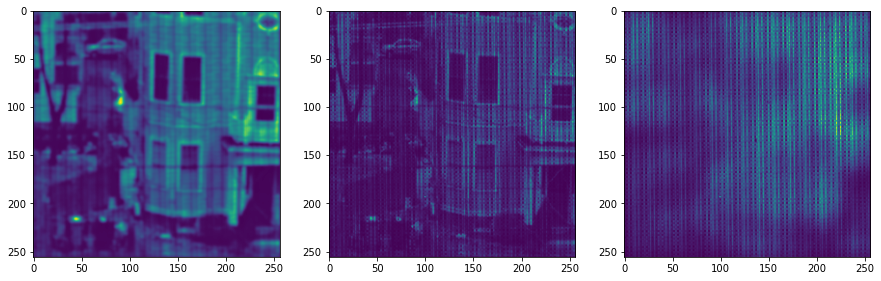

Total Train Loss ( 16 ): 	 0.049 Total Test Loss ( 16 ): 	 0.0386 learned [0.002 0.1  ]


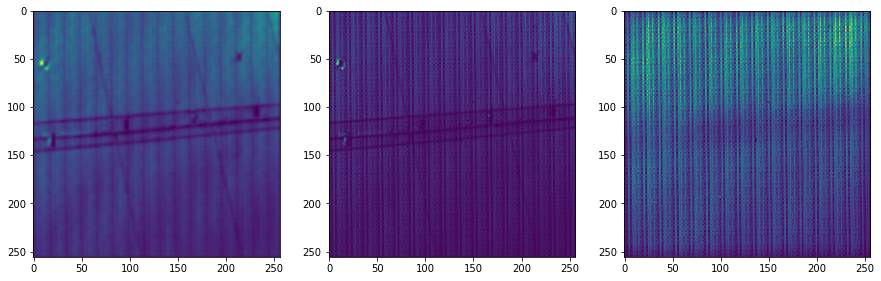

Total Train Loss ( 17 ): 	 0.0465 Total Test Loss ( 17 ): 	 0.0394 learned [0.002 0.1  ]


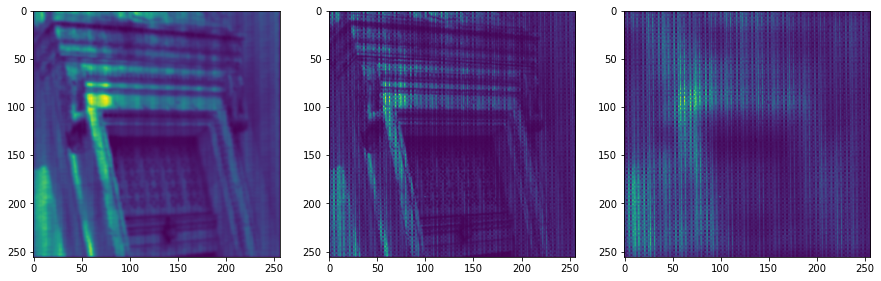

Total Train Loss ( 18 ): 	 0.0472 Total Test Loss ( 18 ): 	 0.0561 learned [0.002 0.1  ]


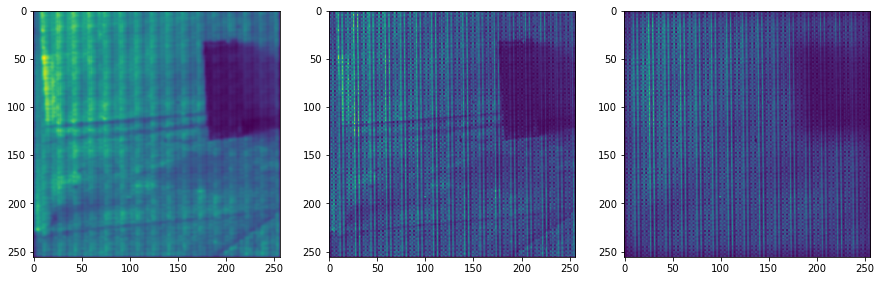

Total Train Loss ( 19 ): 	 0.0496 Total Test Loss ( 19 ): 	 0.0456 learned [0.002 0.1  ]


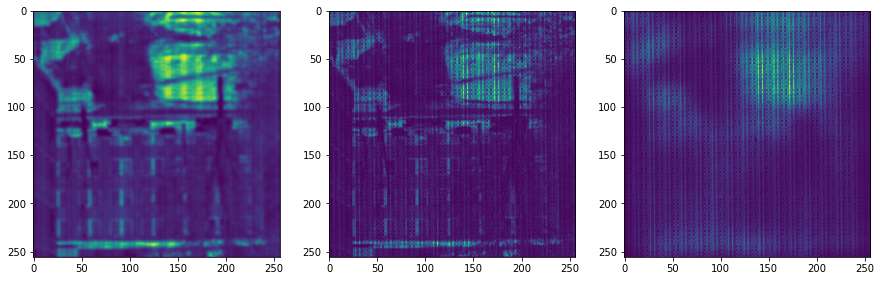

Total Train Loss ( 20 ): 	 0.0491 Total Test Loss ( 20 ): 	 0.0382 learned [0.002 0.1  ]


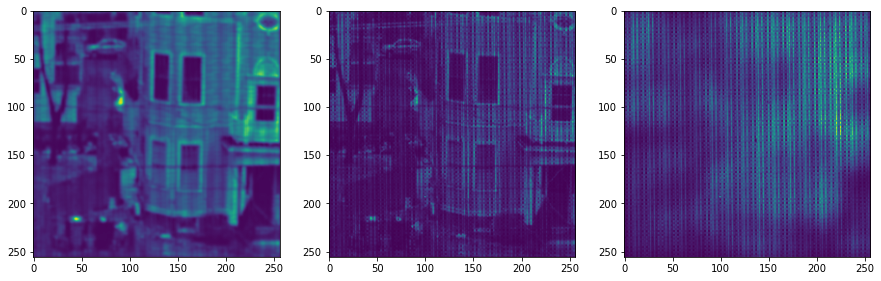

Total Train Loss ( 21 ): 	 0.0482 Total Test Loss ( 21 ): 	 0.0369 learned [0.002 0.1  ]


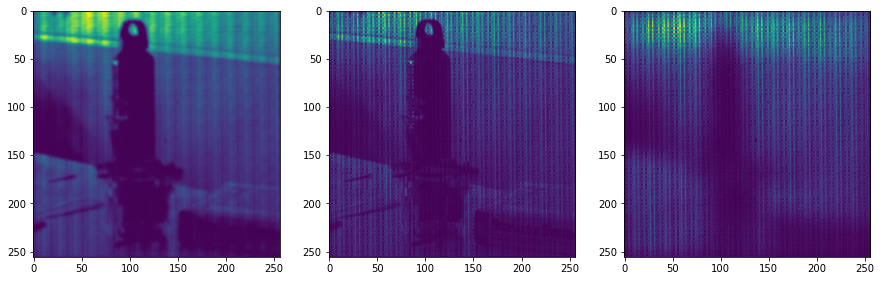

Total Train Loss ( 22 ): 	 0.0557 Total Test Loss ( 22 ): 	 0.0388 learned [0.002 0.1  ]


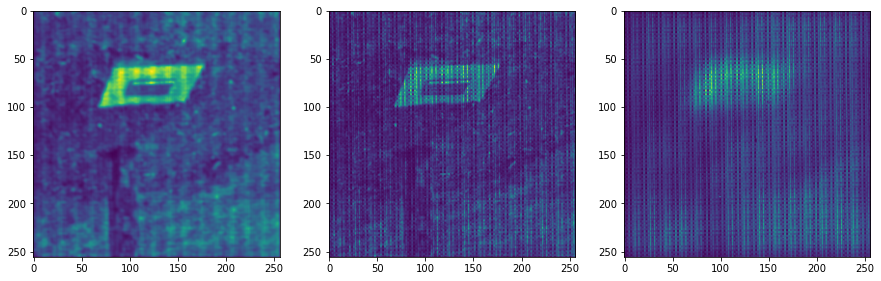

Total Train Loss ( 23 ): 	 0.0472 Total Test Loss ( 23 ): 	 0.0385 learned [0.002 0.1  ]


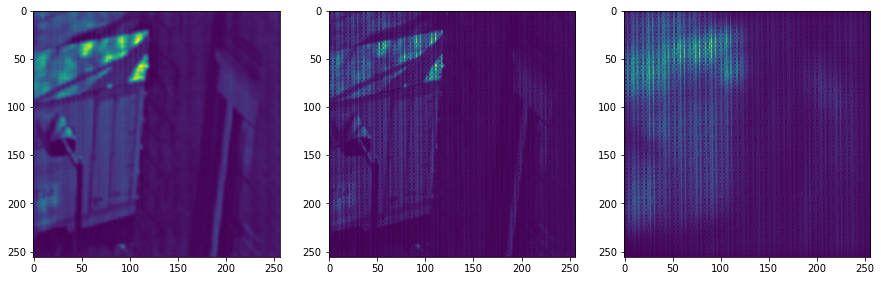

Total Train Loss ( 24 ): 	 0.0468 Total Test Loss ( 24 ): 	 0.0448 learned [0.002 0.1  ]


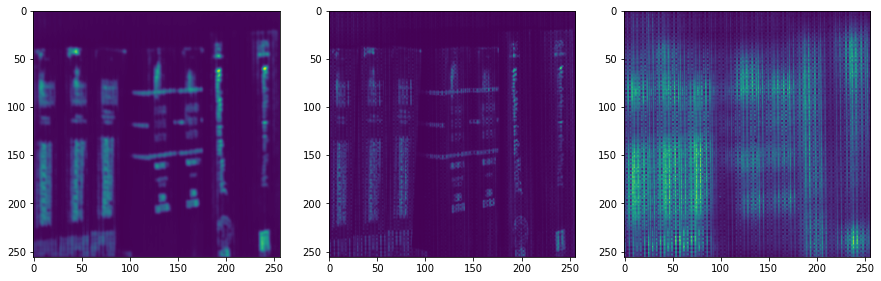

Total Train Loss ( 25 ): 	 0.0475 Total Test Loss ( 25 ): 	 0.0433 learned [0.002 0.1  ]


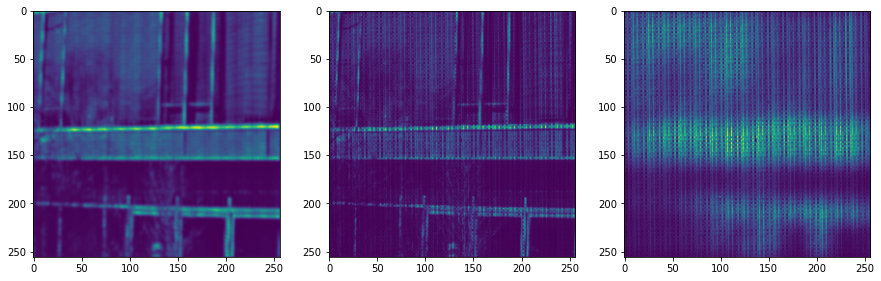

Total Train Loss ( 26 ): 	 0.0471 Total Test Loss ( 26 ): 	 0.0367 learned [0.002 0.1  ]


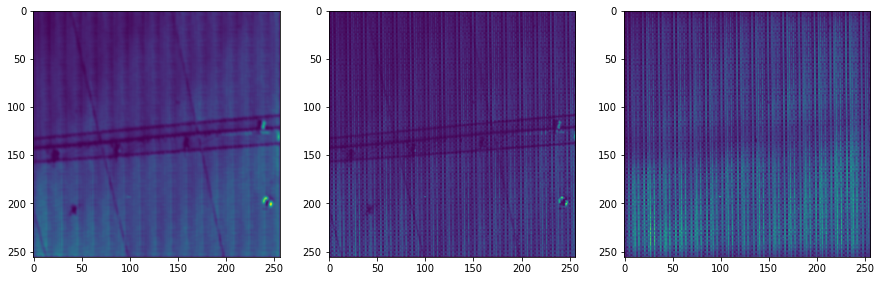

Total Train Loss ( 27 ): 	 0.0456 Total Test Loss ( 27 ): 	 0.0384 learned [0.002 0.1  ]


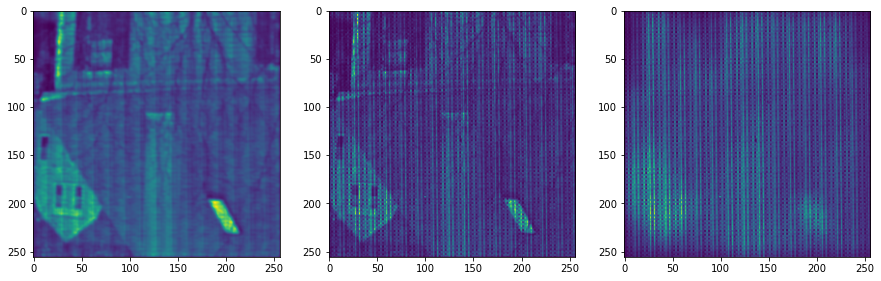

Total Train Loss ( 28 ): 	 0.0457 Total Test Loss ( 28 ): 	 0.0366 learned [0.002 0.1  ]


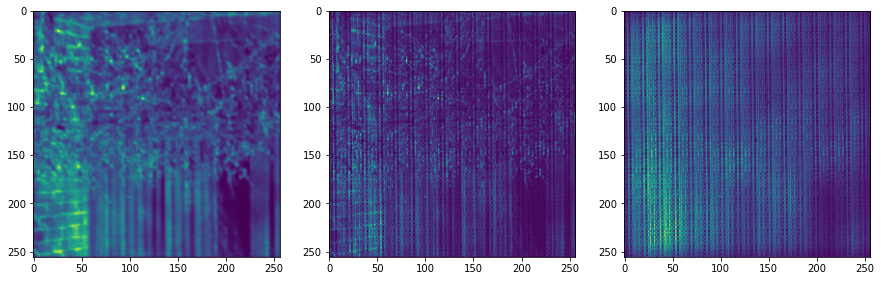

Total Train Loss ( 29 ): 	 0.0466 Total Test Loss ( 29 ): 	 0.0386 learned [0.002 0.1  ]


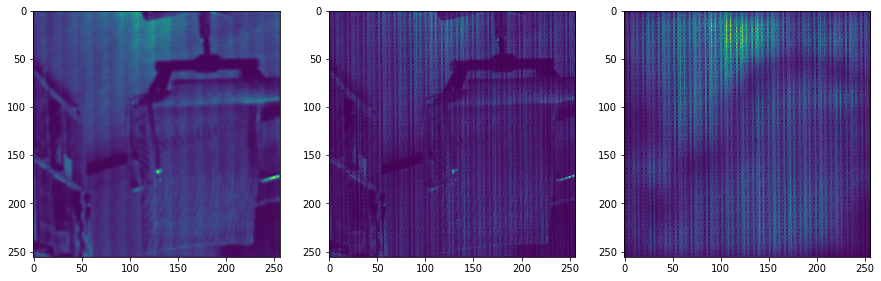

Total Train Loss ( 30 ): 	 0.0454 Total Test Loss ( 30 ): 	 0.0371 learned [0.002 0.1  ]


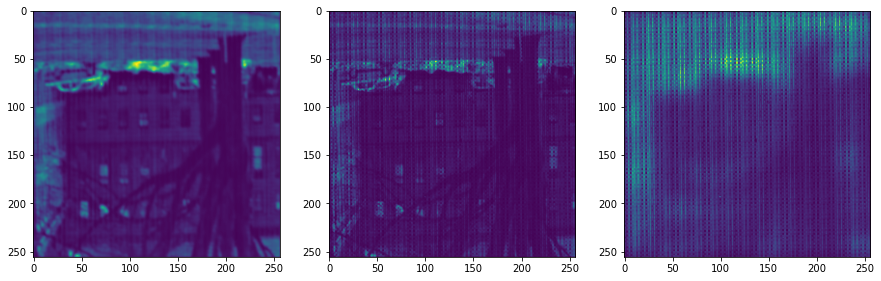

Total Train Loss ( 31 ): 	 0.0454 Total Test Loss ( 31 ): 	 0.0369 learned [0.002 0.1  ]


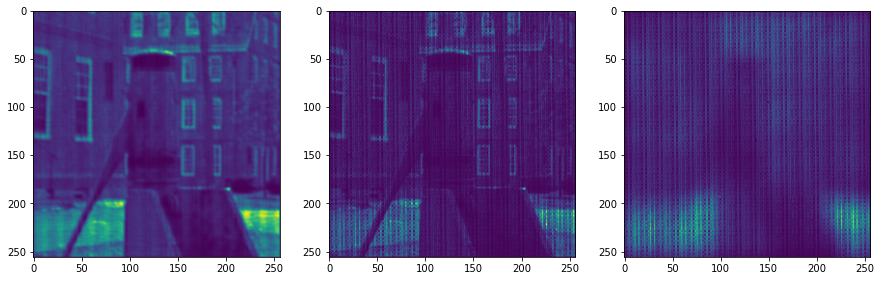

Total Train Loss ( 32 ): 	 0.0483 Total Test Loss ( 32 ): 	 0.0404 learned [0.002 0.1  ]


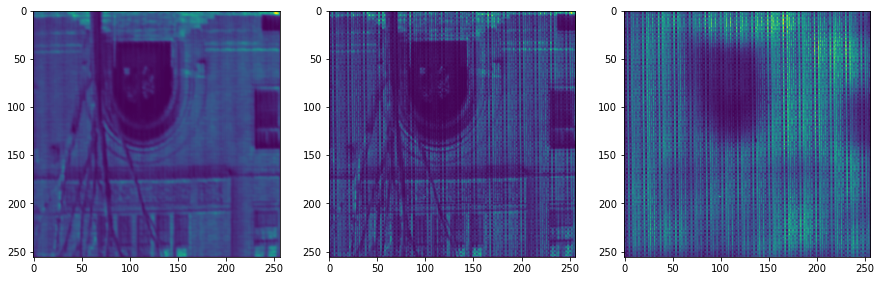

Total Train Loss ( 33 ): 	 0.0449 Total Test Loss ( 33 ): 	 0.0346 learned [0.002 0.1  ]


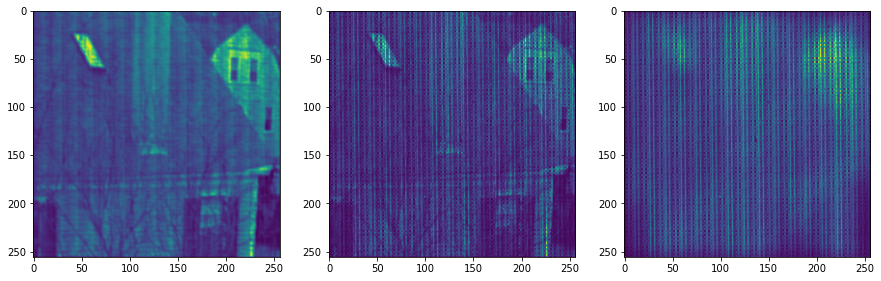

Total Train Loss ( 34 ): 	 0.0447 Total Test Loss ( 34 ): 	 0.0372 learned [0.002 0.1  ]


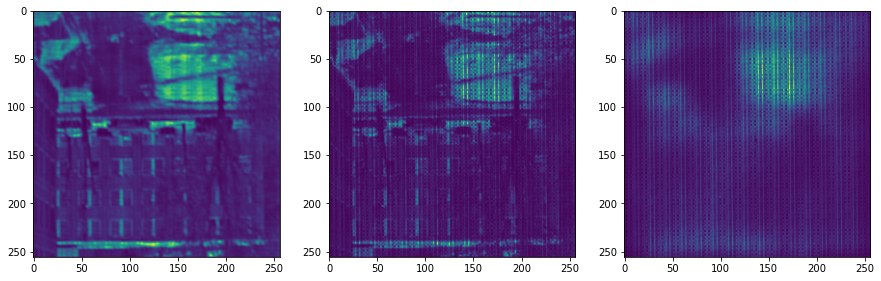

Total Train Loss ( 35 ): 	 0.0461 Total Test Loss ( 35 ): 	 0.0346 learned [0.002 0.1  ]


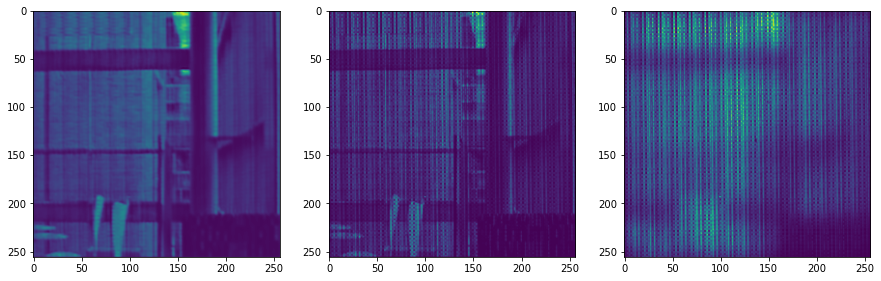

Total Train Loss ( 36 ): 	 0.0466 Total Test Loss ( 36 ): 	 0.0337 learned [0.002 0.1  ]


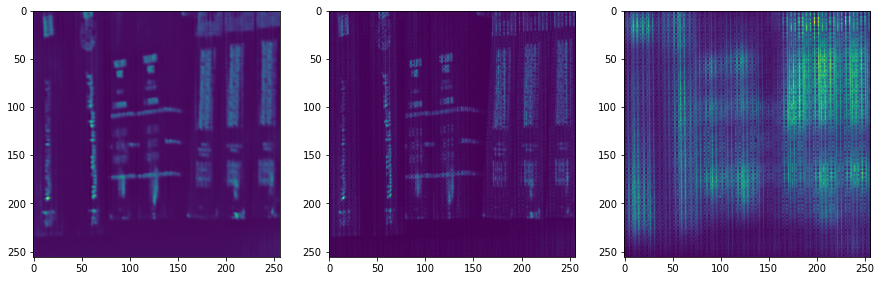

Total Train Loss ( 37 ): 	 0.0462 Total Test Loss ( 37 ): 	 0.0346 learned [0.002 0.1  ]


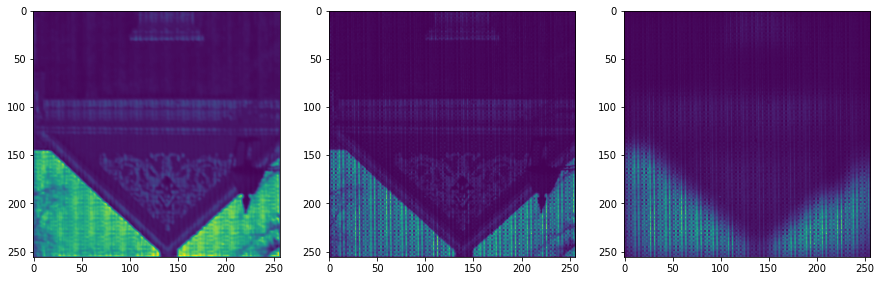

Total Train Loss ( 38 ): 	 0.0444 Total Test Loss ( 38 ): 	 0.0384 learned [0.002 0.1  ]


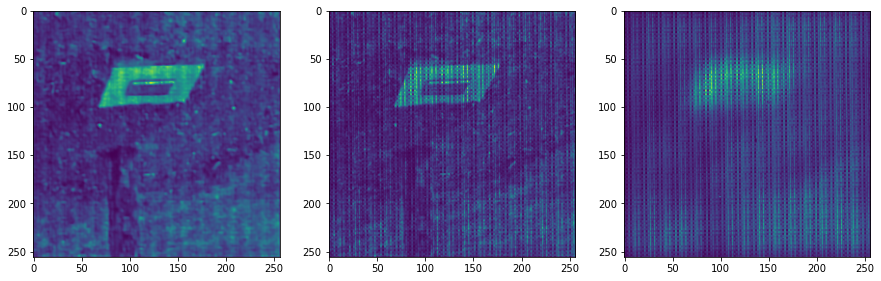

Total Train Loss ( 39 ): 	 0.0459 Total Test Loss ( 39 ): 	 0.0353 learned [0.002 0.1  ]


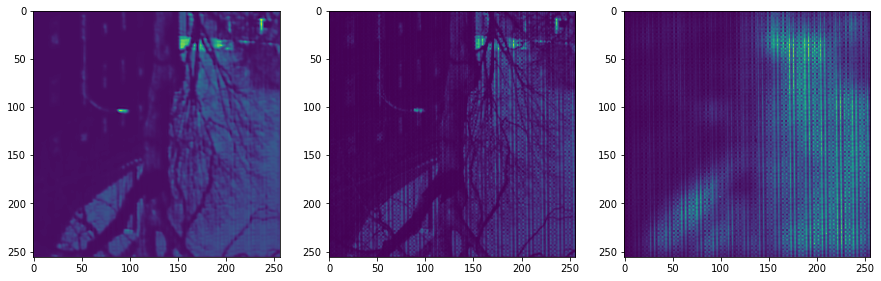

Total Train Loss ( 40 ): 	 0.0517 Total Test Loss ( 40 ): 	 0.0345 learned [0.002 0.1  ]


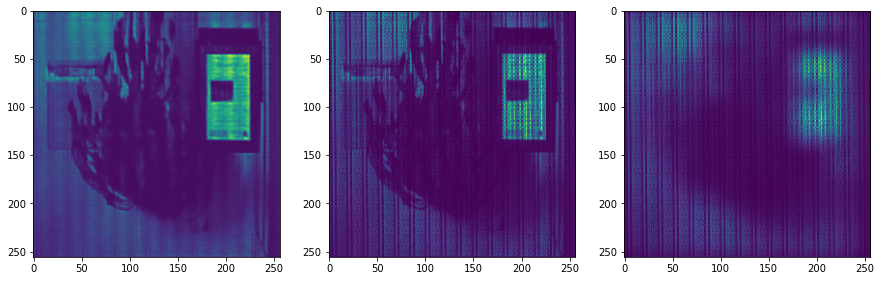

Total Train Loss ( 41 ): 	 0.0458 Total Test Loss ( 41 ): 	 0.0332 learned [0.002 0.1  ]


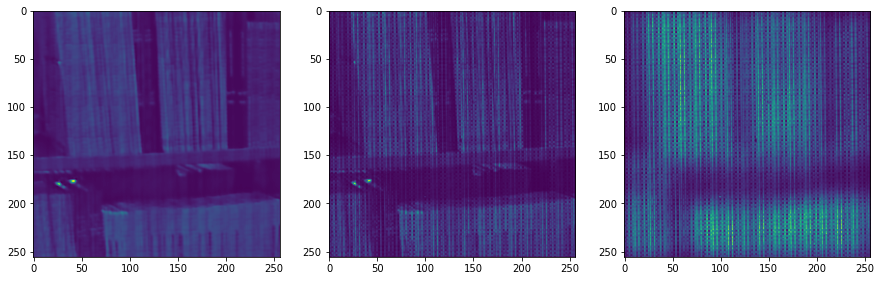

Total Train Loss ( 42 ): 	 0.0466 Total Test Loss ( 42 ): 	 0.0362 learned [0.002 0.1  ]


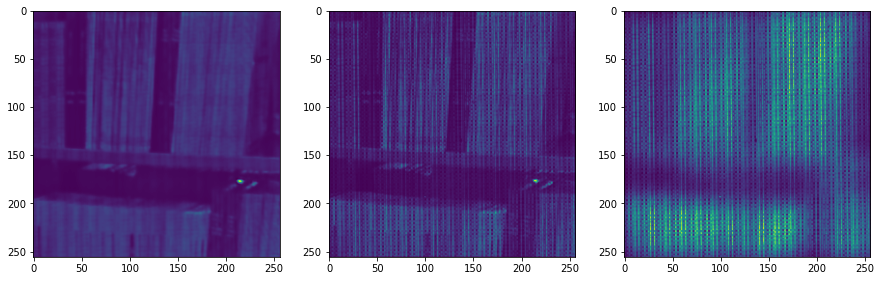

Total Train Loss ( 43 ): 	 0.0427 Total Test Loss ( 43 ): 	 0.0371 learned [0.002 0.1  ]


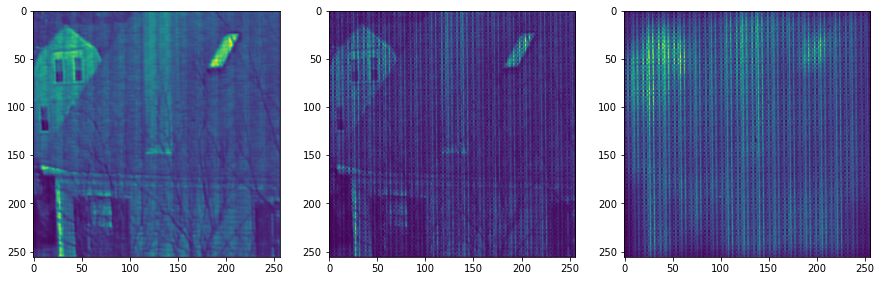

Total Train Loss ( 44 ): 	 0.0456 Total Test Loss ( 44 ): 	 0.0339 learned [0.002 0.1  ]


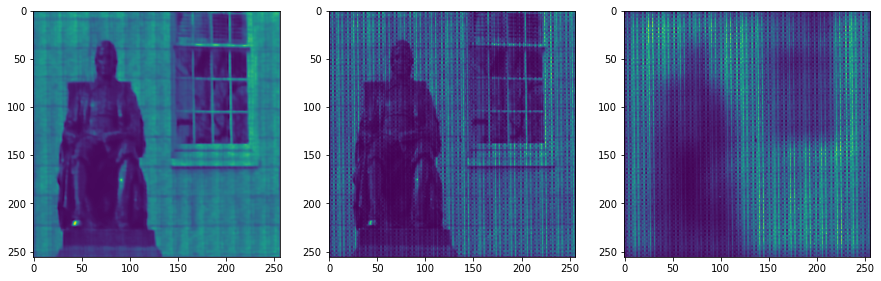

Total Train Loss ( 45 ): 	 0.042 Total Test Loss ( 45 ): 	 0.0411 learned [0.002 0.1  ]


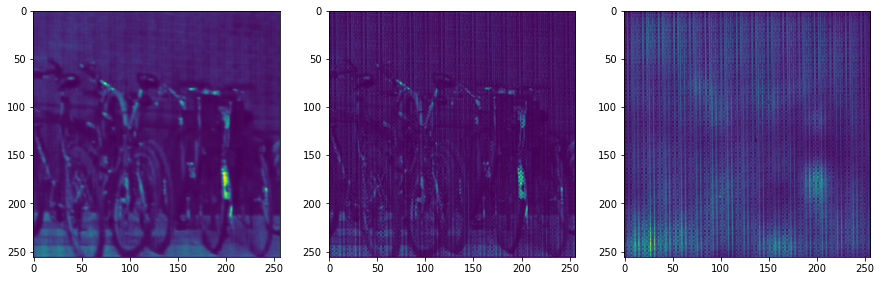

Total Train Loss ( 46 ): 	 0.05 Total Test Loss ( 46 ): 	 0.0358 learned [0.002 0.1  ]


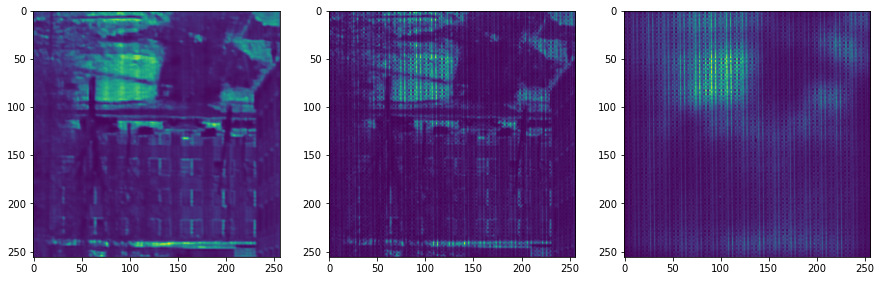

Total Train Loss ( 47 ): 	 0.0474 Total Test Loss ( 47 ): 	 0.0372 learned [0.002 0.1  ]


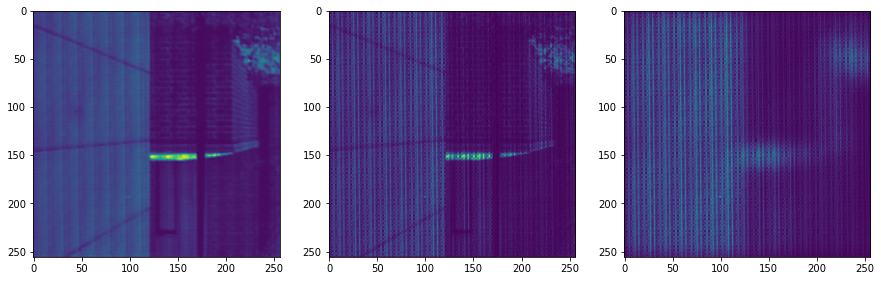

Total Train Loss ( 48 ): 	 0.0457 Total Test Loss ( 48 ): 	 0.0365 learned [0.002 0.1  ]


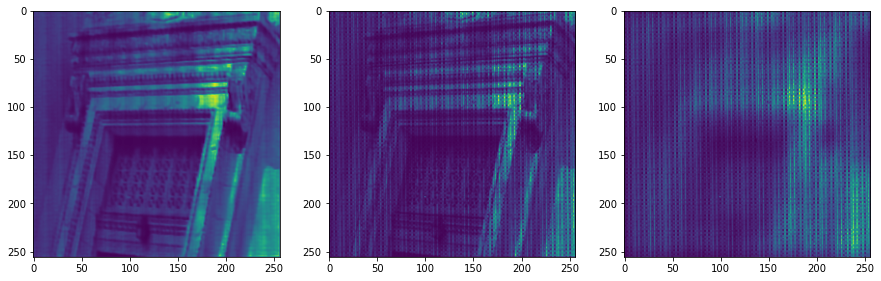

Total Train Loss ( 49 ): 	 0.0439 Total Test Loss ( 49 ): 	 0.0346 learned [0.002 0.1  ]


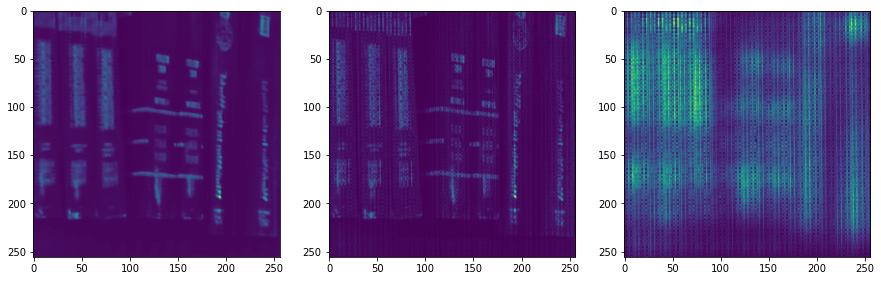

Total Train Loss ( 50 ): 	 0.0446 Total Test Loss ( 50 ): 	 0.0404 learned [0.002 0.1  ]


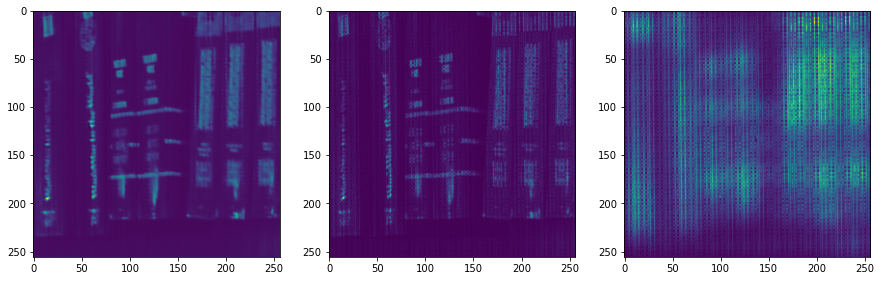

Total Train Loss ( 51 ): 	 0.044 Total Test Loss ( 51 ): 	 0.0366 learned [0.002 0.1  ]


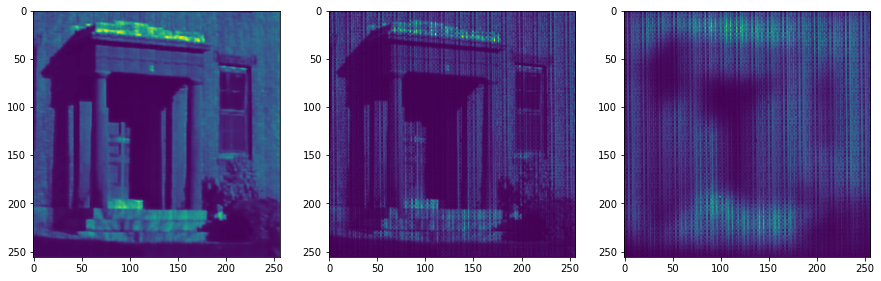

Total Train Loss ( 52 ): 	 0.0442 Total Test Loss ( 52 ): 	 0.0385 learned [0.002 0.1  ]


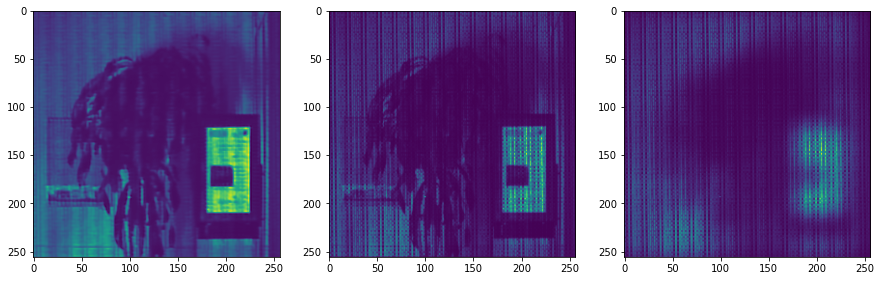

Total Train Loss ( 53 ): 	 0.0442 Total Test Loss ( 53 ): 	 0.0343 learned [0.002 0.1  ]


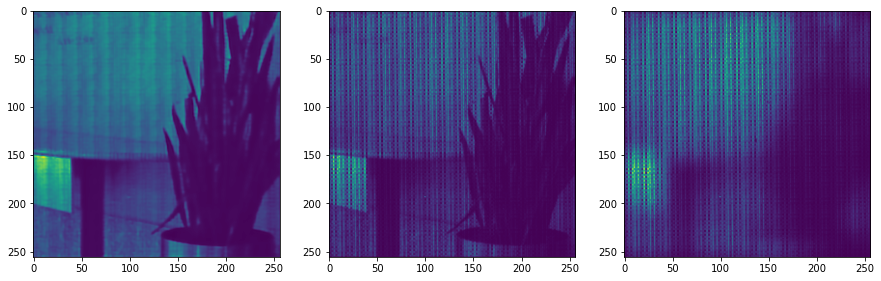

Total Train Loss ( 54 ): 	 0.0449 Total Test Loss ( 54 ): 	 0.0334 learned [0.002 0.1  ]


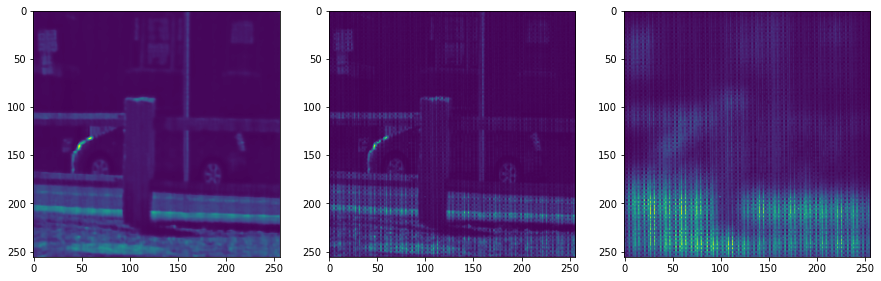

Total Train Loss ( 55 ): 	 0.0432 Total Test Loss ( 55 ): 	 0.0381 learned [0.002 0.1  ]


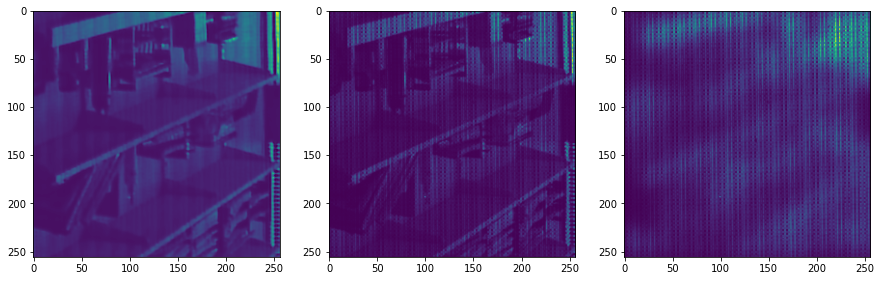

Total Train Loss ( 56 ): 	 0.0449 Total Test Loss ( 56 ): 	 0.0365 learned [0.002 0.1  ]


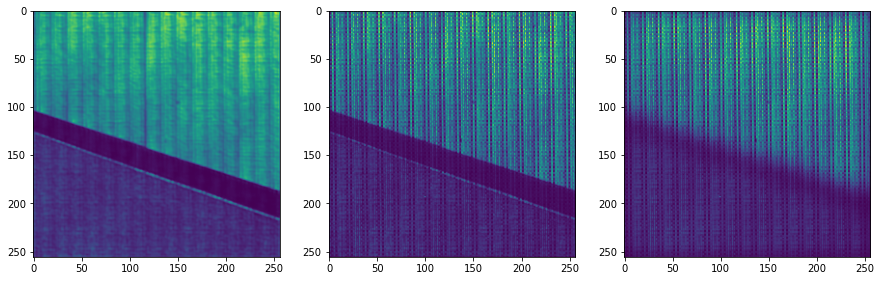

Total Train Loss ( 57 ): 	 0.0411 Total Test Loss ( 57 ): 	 0.0341 learned [0.002 0.1  ]


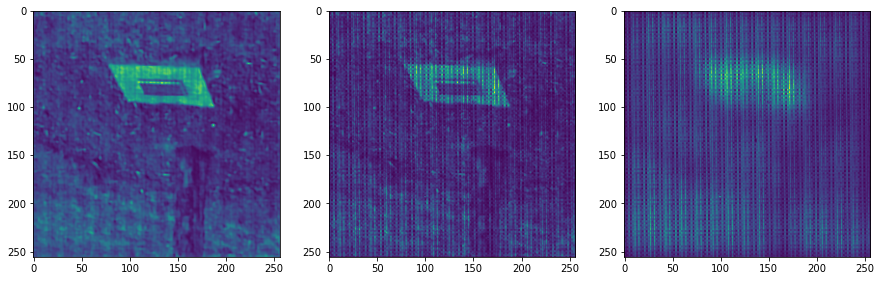

Total Train Loss ( 58 ): 	 0.0427 Total Test Loss ( 58 ): 	 0.0344 learned [0.002 0.1  ]


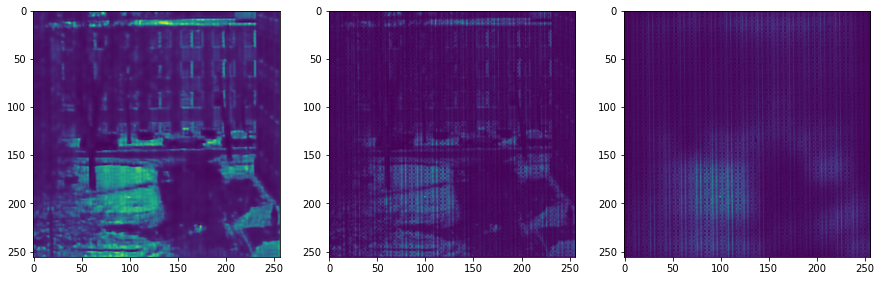

Total Train Loss ( 59 ): 	 0.0434 Total Test Loss ( 59 ): 	 0.0368 learned [0.002 0.1  ]


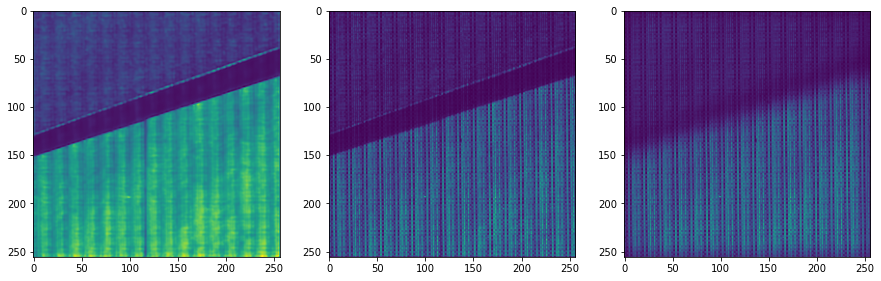

Total Train Loss ( 60 ): 	 0.0434 Total Test Loss ( 60 ): 	 0.0347 learned [0.002 0.1  ]


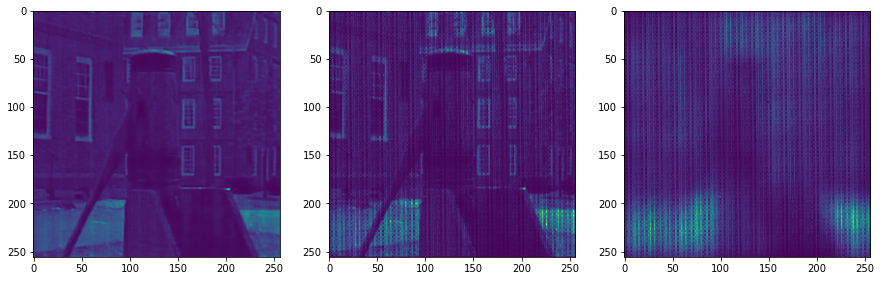

Total Train Loss ( 61 ): 	 0.0444 Total Test Loss ( 61 ): 	 0.0329 learned [0.002 0.1  ]


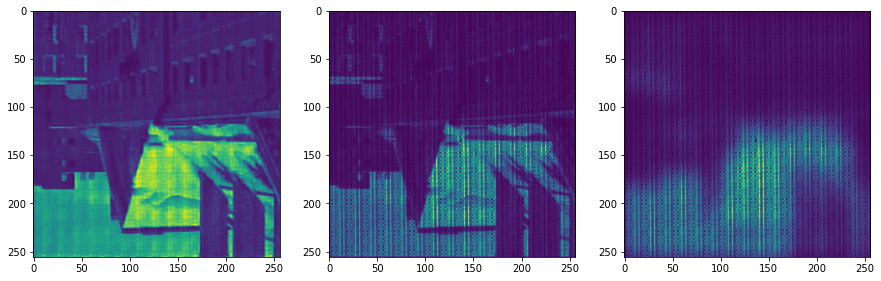

Total Train Loss ( 62 ): 	 0.0426 Total Test Loss ( 62 ): 	 0.033 learned [0.002 0.1  ]


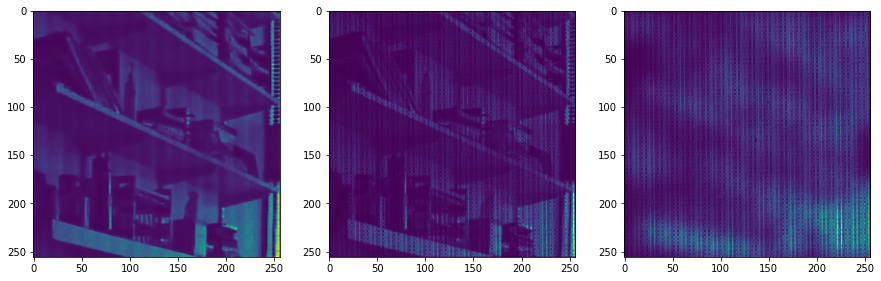

Total Train Loss ( 63 ): 	 0.0442 Total Test Loss ( 63 ): 	 0.0322 learned [0.002 0.1  ]


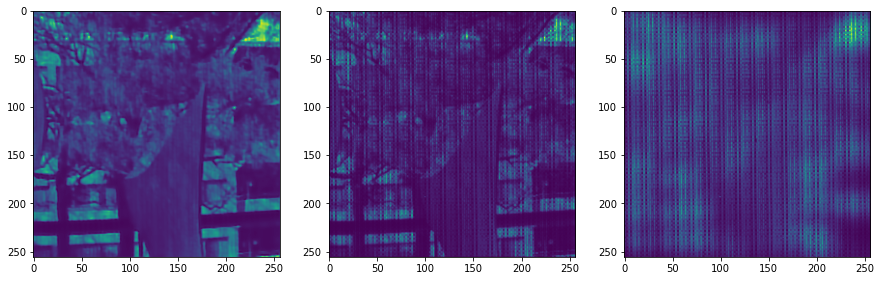

Total Train Loss ( 64 ): 	 0.0443 Total Test Loss ( 64 ): 	 0.0318 learned [0.002 0.1  ]


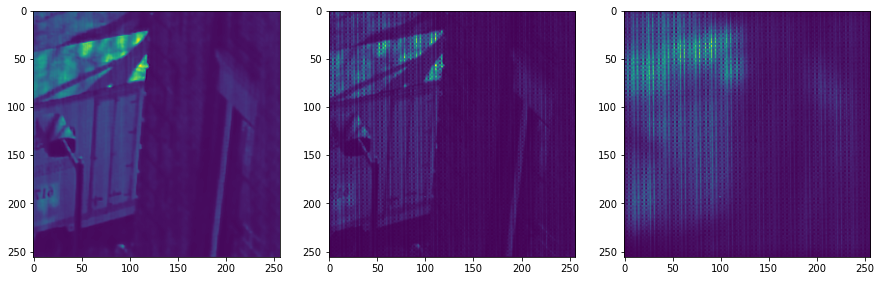

Total Train Loss ( 65 ): 	 0.0418 Total Test Loss ( 65 ): 	 0.0351 learned [0.002 0.1  ]


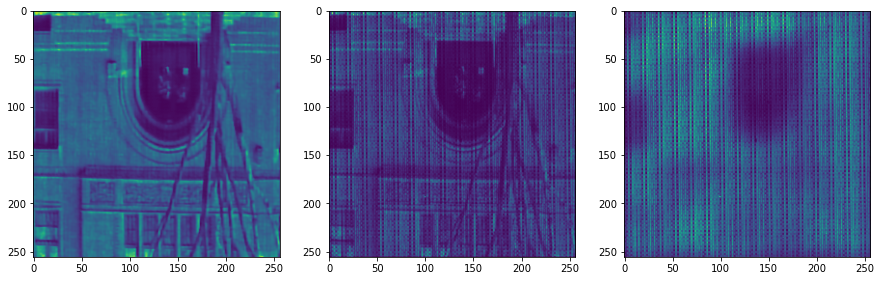

Total Train Loss ( 66 ): 	 0.042 Total Test Loss ( 66 ): 	 0.0348 learned [0.002 0.1  ]


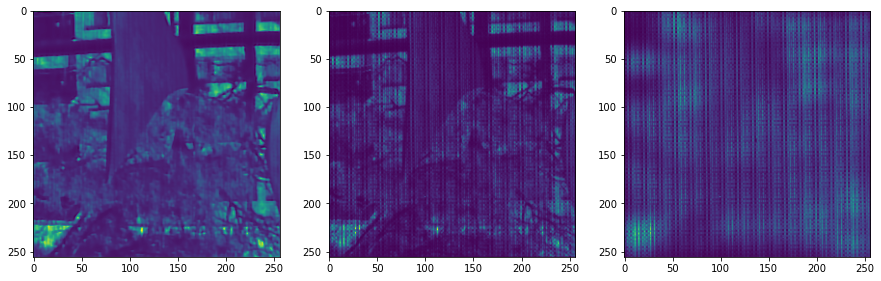

Total Train Loss ( 67 ): 	 0.043 Total Test Loss ( 67 ): 	 0.0354 learned [0.002 0.1  ]


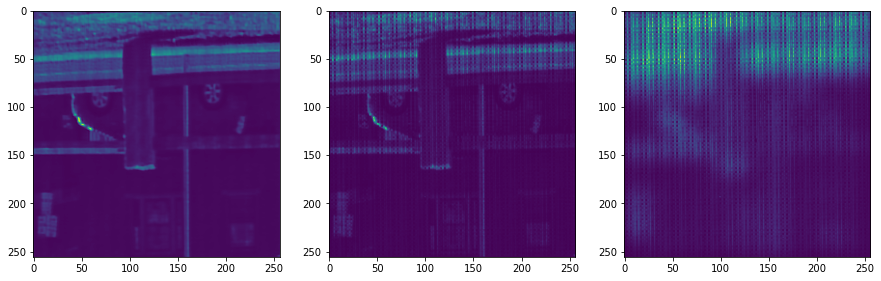

Total Train Loss ( 68 ): 	 0.0436 Total Test Loss ( 68 ): 	 0.0318 learned [0.002 0.1  ]


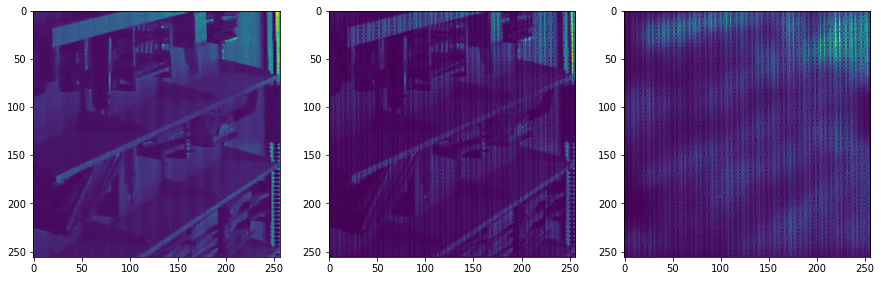

Total Train Loss ( 69 ): 	 0.0428 Total Test Loss ( 69 ): 	 0.0328 learned [0.002 0.1  ]


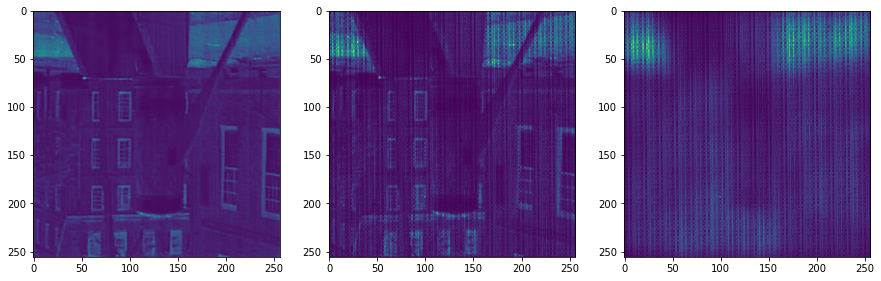

Total Train Loss ( 70 ): 	 0.0448 Total Test Loss ( 70 ): 	 0.0337 learned [0.002 0.1  ]


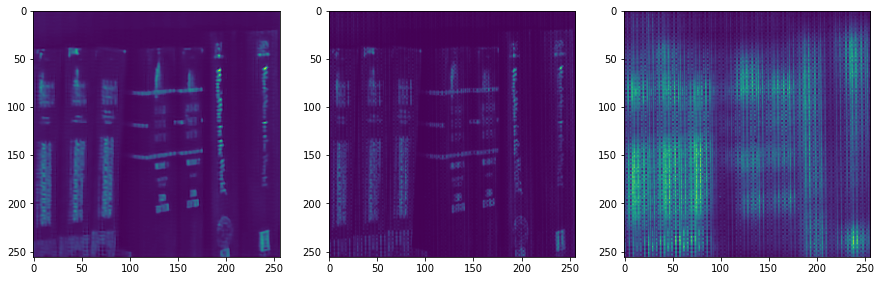

Total Train Loss ( 71 ): 	 0.042 Total Test Loss ( 71 ): 	 0.0318 learned [0.002 0.1  ]


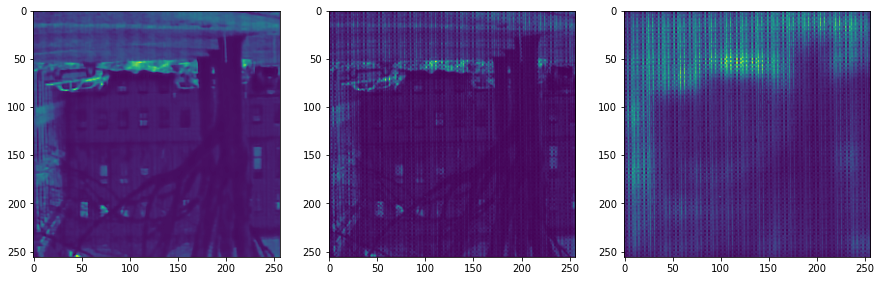

Total Train Loss ( 72 ): 	 0.0439 Total Test Loss ( 72 ): 	 0.0343 learned [0.002 0.1  ]


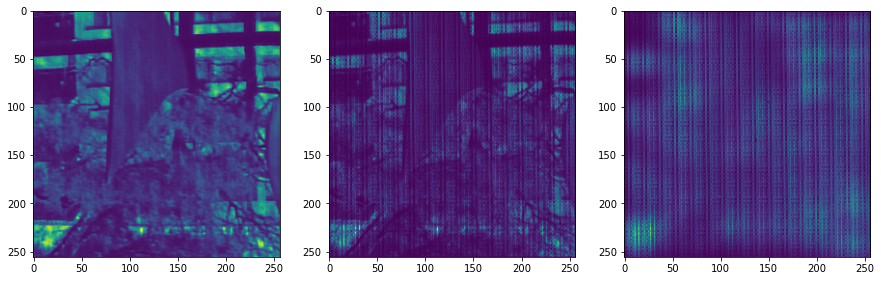

Total Train Loss ( 73 ): 	 0.0463 Total Test Loss ( 73 ): 	 0.0329 learned [0.002 0.1  ]


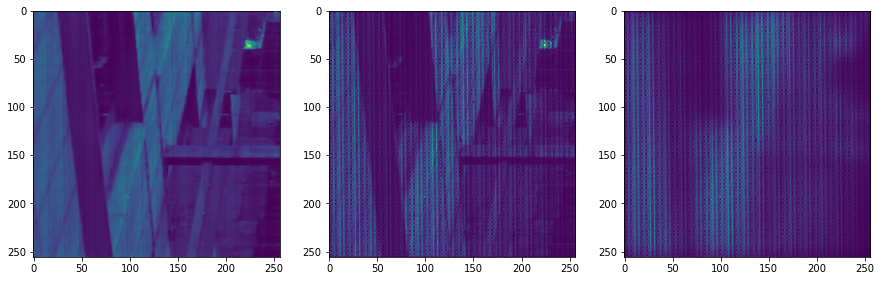

Total Train Loss ( 74 ): 	 0.0419 Total Test Loss ( 74 ): 	 0.0326 learned [0.002 0.1  ]


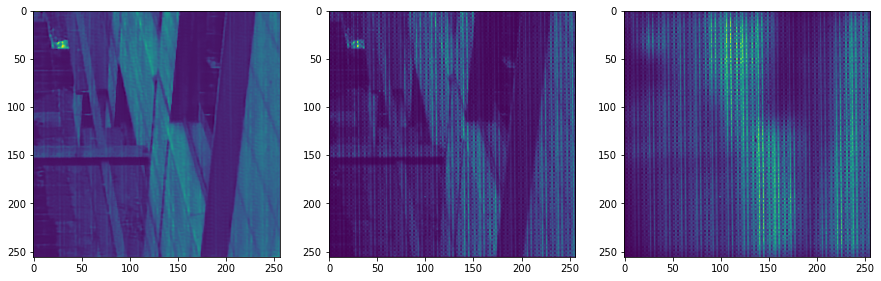

Total Train Loss ( 75 ): 	 0.0424 Total Test Loss ( 75 ): 	 0.0342 learned [0.002 0.1  ]


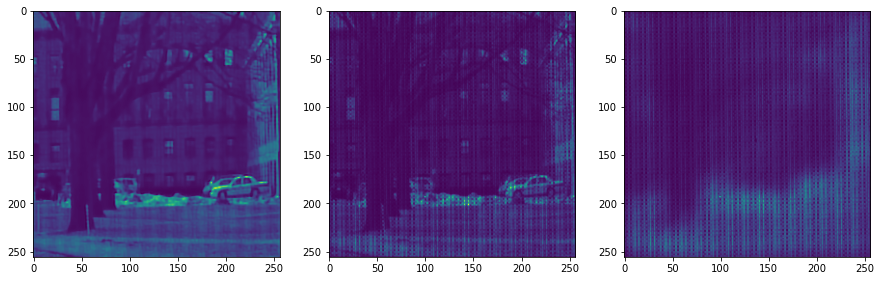

Total Train Loss ( 76 ): 	 0.044 Total Test Loss ( 76 ): 	 0.0307 learned [0.002 0.1  ]


In [ ]:
if not os.path.exists(save_folder):
    os.makedirs(save_folder)
    
epochs = 2000 
w_list = []
test_loss_list = []
train_loss_list = []

for i in range(epochs): # Outerloop with epochs
    train_loss = 0
    for sample in train_dataloader:   # Training Loop (go through each image in the training set)
        output = model(sample['image'].to(device))   # Compute the output image 
        loss = loss_function(output, sample['image'].to(device)) # Compute the loss
        train_loss += loss.item()
        
        # Update the model based on the loss
        optimizer.zero_grad() 
        loss.backward()  
        optimizer.step() 
        
        # Enforce a physical constraint on the parameters 
        model.model1.w_blur.data = torch.clip(model.model1.w_blur.data, .0006, 1)
        
        net_output_np = output.detach().cpu().numpy()[0]
        sim_meas_np = model.output1.detach().cpu().numpy()[0]
        
        #break 
    train_loss_list.append(train_loss/training_data.__len__())
    test_loss = run_test() #run current iteration of model on test
    test_loss_list.append(test_loss)
    

    fig, ax = plt.subplots(1,1 + num_input_images, figsize = (15,5))
    ax[0].imshow(np.mean(net_output_np,0))
    for j in range(0,num_input_images):
        ax[j+1].imshow(sim_meas_np[j])

    plt.show()
    
    torch.save(model.state_dict(), save_folder + 'saved_model_' 'ep'+str(i)+'_testloss_'+str(test_loss) + '.pt')
    scipy.io.savemat(save_folder+'saved_lists.mat', 
                     {'test_loss': test_loss_list,
                     'train_loss': train_loss_list,
                     'w_list': w_list})
    
    print("Total Train Loss (", i, "): \t", round(train_loss_list[-1], 4),
          "Total Test Loss (", i, "): \t", round(test_loss_list[-1], 4),
          "learned", model.model1.w_blur.data.detach().cpu().numpy())
    

    

In [51]:
with torch.no_grad():
    sample = training_data.__getitem__(0)
    sample['image'] = sample['image'].unsqueeze(0)
    output = model(sample['image'].to(device))  
    meas = model.model1(sample['image'].to(device))
       
net_output_np= output.detach().cpu().numpy()[0]
net_input_np= meas.detach().cpu().numpy()
gt_np= sample['image'].detach().cpu().numpy()[0]

fig, ax = plt.subplots(1,2+ num_input_images, figsize = (15,5))
ax[0].imshow(np.mean(net_output_np,0))
ax[0].set_title('net output')
ax[1].imshow(np.mean(np.abs(net_output_np - gt_np), 0));
ax[1].set_title('error image')
for i in range(0,num_input_images):
    ax[2+i].imshow(net_input_np[0,i])
    ax[2+i].set_title('input #'+ str(i))


NameError: name 'model' is not defined

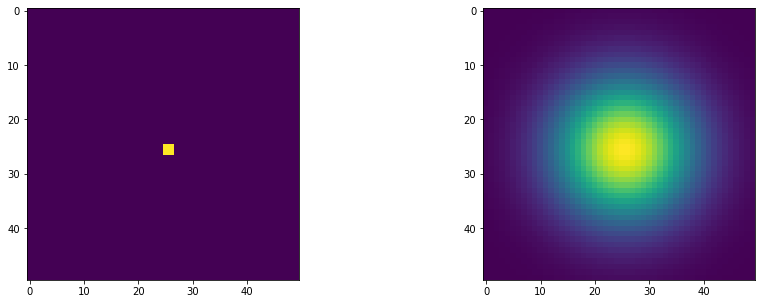

In [27]:

fig, ax = plt.subplots(1,num_input_images, figsize = (15,5))
for i in range(0,num_input_images):
    if model.model1.blur_type == 'symmetric':
        psf1= torch.exp(-((model.model1.X/model.model1.w_blur[i])**2+(model.model1.Y/model.model1.w_blur[i])**2))
    else:
        psf1= torch.exp(-((model.model1.X/model.model1.w_blur[i,0])**2+(model.model1.Y/model.model1.w_blur[i,1])**2))
    if num_input_images == 1:
        ax.imshow(psf1[102:152, 102:152].cpu().detach().numpy())
    else:
        ax[i].imshow(psf1[102:152, 102:152].cpu().detach().numpy())